# Data loading and understanding

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Import libraries
from keras import backend as K
import keras
import cv2
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from keras.layers import *
from tensorflow.keras import optimizers
from keras.models import model_from_json
import numpy as np
import matplotlib.pyplot as plt
import os
from scipy.ndimage.interpolation import rotate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input
from keras.models import load_model
import tensorflow as tf


In [ ]:
# extract ICDAR 2013 dataset
!tar xvzf /content/drive/MyDrive/AI2/Data.tar.gz

images/img_58.jpg
images/img_228.jpg
ground_truth/gt_109.txt
images/243.jpg
images/278.jpg
images/img_45.jpg
images/321.jpg
images/img_115.jpg
ground_truth/gt_266.txt
ground_truth/gt_img_68.txt
images/img_23.jpg
images/196.jpg
ground_truth/gt_231.txt
ground_truth/gt_img_33.txt
images/img_34.jpg
images/161.jpg
ground_truth/gt_184.txt
images/img_126.jpg
images/img_69.jpg
images/289.jpg
images/img_137.jpg
images/img_190.jpg
images/img_204.jpg
images/254.jpg
ground_truth/gt_277.txt
ground_truth/gt_img_79.txt
ground_truth/gt_img_170.txt
ground_truth/gt_img_106.txt
ground_truth/gt_320.txt
ground_truth/gt_242.txt
ground_truth/gt_img_44.txt
images/img_148.jpg
images/108.jpg
images/172.jpg
ground_truth/gt_195.txt
ground_truth/gt_209.txt
images/230.jpg
images/img_215.jpg
ground_truth/gt_160.txt
ground_truth/gt_img_6.txt
images/265.jpg
ground_truth/gt_288.txt
ground_truth/gt_img_181.txt
ground_truth/gt_img_117.txt
images/img_102.jpg
ground_truth/gt_253.txt
ground_truth/gt_img_55.txt
images/img_10

# Data Preprocessing

In [ ]:
import numpy as np
import pandas as pd
import cv2
import os
import tqdm
from scipy.io import loadmat
import matplotlib.pyplot as plt



image_path = '/content/images/'
gt_path = '/content/ground_truth/'
train_image_paths = []
train_gt_paths = []


for new_file in tqdm.tqdm(os.listdir(gt_path)):
    
    name_split = new_file.split('.')
    image_name = name_split[0][3:]
    image_name = image_name + '.jpg'
    
    if 'gt' in new_file:
        image_name = name_split[0][3:]
        image_name = image_name + '.jpg'
    
    path_img = os.path.join(image_path , image_name)
    train_image_paths.append(path_img)
    train_gt_paths.append(os.path.join(gt_path , new_file))



X_final = []
Y_final = []
grid_h = 16
grid_w = 16
img_w = 512
img_h = 512



for z in tqdm.tqdm(range(len(train_image_paths))):
    
    new_file = train_image_paths[z]
    x = cv2.imread(train_image_paths[z])
    x_sl = 512/x.shape[1]
    y_sl = 512/x.shape[0]
    
    img = cv2.resize(x,(512,512))
    
    
    X_final.append(img)
    
    i = " "
    
    if 'img' in new_file:
        i = ", "
    
    Y = np.zeros((grid_h,grid_w,1,5))
    
    file = train_gt_paths[z]
    name = open(file , 'r')
    data = name.read()
    data = data.split("\n")
    data = data[:-1]
    
    
    for li in data:
        temp_list = []
        file_data = li.split(i)
        strr = file_data[4]
        bb = file_data[:4]
        
        xmin = int(bb[0])*x_sl
        xmax = int(bb[2])*x_sl
        ymin = int(bb[1])*y_sl
        ymax = int(bb[3])*y_sl
        
        w = (xmax - xmin)/img_w
        h = (ymax - ymin)/img_h
        
        x = ((xmax + xmin)/2)/img_w
        y = ((ymax + ymin)/2)/img_h
        x = x * grid_w
        y = y * grid_h
        
        Y[int(y),int(x),0,0] = 1
        Y[int(y),int(x),0,1] = x - int(x)
        Y[int(y),int(x),0,2] = y - int(y)
        Y[int(y),int(x),0,3] = w
        Y[int(y),int(x),0,4] = h
        
    #plt.imshow(te)
    #plt.show()
    
    Y_final.append(Y)

X = np.array(X_final)
X_final = []
Y = np.array(Y_final)
Y_final = []

X = (X - 127.5)/127.5

np.save('X.npy',X)
np.save('Y.npy',Y)

100%|██████████| 461/461 [00:16<00:00, 27.56it/s]


In [ ]:
#Variable Definition
img_w = 512
img_h = 512
channels = 3
classes = 1
info = 5
grid_w = 16
grid_h = 16

In [ ]:
# create the numpy arrays of X and Y
X = np.load('X.npy')
Y = np.load('Y.npy')

In [ ]:
print(X.shape , Y.shape)

(461, 512, 512, 3) (461, 16, 16, 1, 5)


In [ ]:
X_train , X_val , Y_train , Y_val  = train_test_split(X,Y,train_size = 0.75 , random_state=251203021)
X_test = X_val[:16]
Y_test = Y_val[:16]
X_val = X_val[16:]
Y_val = Y_val[16:]
X = []
Y = []

In [ ]:
X_test.shape

(16, 512, 512, 3)

In [ ]:
np.save("X_train", X_train)
np.save("X_val", X_val)
np.save("Y_train", Y_train)
np.save("Y_val", Y_val)
np.save("X_test", X_test)
np.save("Y_test", Y_test)

## Data Augmentation

In [ ]:
import shutil
shutil.copy("/content/X_train.npy", "/content/drive/MyDrive/AI2/train")
shutil.copy("/content/Y_train.npy", "/content/drive/MyDrive/AI2/train")
shutil.copy("/content/X_val.npy", "/content/drive/MyDrive/AI2/validate")
shutil.copy("/content/Y_val.npy", "/content/drive/MyDrive/AI2/validate")

'/content/drive/MyDrive/AI2/validate'

In [ ]:
train_datagen = ImageDataGenerator(
                                  rescale=1./255,                        
                                  shear_range=0.2,                       
                                  horizontal_flip=False,                  
                                  vertical_flip=True,
                                  rotation_range = 90,
                                  width_shift_range=0.2,
                                  height_shift_range=0.2,
                                  brightness_range=[0.2,1.0],
                                  zoom_range=[0.5,1.0], 
                                  featurewise_center=True,
                                  featurewise_std_normalization=True,
                                  preprocessing_function=preprocess_input                
                                  )

In [ ]:
val_datagen = ImageDataGenerator(
                                  rescale=1./255,                        
                                  shear_range=0.2,                                          
                                  horizontal_flip=False,                  
                                  vertical_flip=True,
                                  rotation_range = 90,
                                  width_shift_range=0.2,
                                  height_shift_range=0.2,
                                  brightness_range=[0.2,1.0],
                                  zoom_range=[0.5,1.0], 
                                  featurewise_center=True,
                                  featurewise_std_normalization=True,
                                  preprocessing_function=preprocess_input             
                                  )

In [ ]:
train_datagen.fit(X_train)
val_datagen.fit(X_val)

In [ ]:
#define model
# input : 512,512,3
# output : 16,16,1,5

def save_model(model, fileName):
    model_json = model.to_json()
    with open(fileName, "w") as json_file:
        json_file.write(model_json)
       
def load_model(strr):        
    json_file = open(strr, 'r')
    loaded_model_json = json_file.read()
    #print(loaded_model_json)
    json_file.close()
    loaded_model = model_from_json(loaded_model_json)
    return loaded_model
  
def yolo_model(input_shape):
    
    
    inp = tf.keras.Input(input_shape)
   
    model = tf.keras.applications.MobileNetV2( input_tensor= inp , include_top=False, weights='imagenet')
    last_layer = model.output
    
    conv = tf.keras.layers.Conv2D(512,(3,3) , activation='relu' , padding='same')(last_layer)
    conv = tf.keras.layers.Dropout(0.4)(conv)
    bn = tf.keras.layers.BatchNormalization()(conv)
    lr = tf.keras.layers.LeakyReLU(alpha=0.1)(bn)
    
    
    conv = tf.keras.layers.Conv2D(128,(3,3) , activation='relu' , padding='same')(lr)
    conv = tf.keras.layers.Dropout(0.4)(conv)
    bn = tf.keras.layers.BatchNormalization()(conv)
    lr = tf.keras.layers.LeakyReLU(alpha=0.1)(bn)
    
    
    conv = tf.keras.layers.Conv2D(5,(3,3) , activation='relu' , padding='same')(lr)
    
    final = tf.keras.layers.Reshape((grid_h,grid_w,classes,info))(conv)
    
    model = tf.keras.models.Model(inp,final)
    
    return model

# Training the model

In [ ]:
#define utils

#optimizer
opt = optimizers.Adam(learning_rate=1e-6, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)

#checkpoint
checkpoint = ModelCheckpoint('text_detect.h5', monitor='val_loss', verbose=1, save_best_only=True, mode='min',save_freq=1)

In [ ]:
#define loss function
def yolo_loss_func(y_true,y_pred):
    # y_true : 16,16,1,5
    # y_pred : 16,16,1,5
    l_coords = 5.0
    l_noob = 0.5
    coords = y_true[:,:,:,:,0] * l_coords
    noobs = (-1*(y_true[:,:,:,:,0] - 1)*l_noob)
    p_pred = y_pred[:,:,:,:,0]
    p_true = y_true[:,:,:,:,0]
    x_true = y_true[:,:,:,:,1]
    x_pred = y_pred[:,:,:,:,1]
    yy_true = y_true[:,:,:,:,2]
    yy_pred = y_pred[:,:,:,:,2]
    w_true = y_true[:,:,:,:,3]
    w_pred = y_pred[:,:,:,:,3]
    h_true = y_true[:,:,:,:,4]
    h_pred = y_pred[:,:,:,:,4]
    
    p_loss_absent = K.sum(K.square(p_pred - p_true)*noobs)
    p_loss_present = K.sum(K.square(p_pred - p_true))
    x_loss = K.sum(K.square(x_pred - x_true)*coords)
    yy_loss = K.sum(K.square(yy_pred - yy_true)*coords)
    xy_loss = x_loss + yy_loss
    w_loss = K.sum(K.square(K.sqrt(w_pred) - K.sqrt(w_true))*coords)
    h_loss = K.sum(K.square(K.sqrt(h_pred) - K.sqrt(h_true))*coords)
    wh_loss = w_loss + h_loss
    
    loss = p_loss_absent + p_loss_present + xy_loss + wh_loss
    
    return loss

In [ ]:
#load and save model
input_size = (img_h,img_w,channels)

model = yolo_model(input_size)

print(model.summary())

9420800/9406464 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 256, 256, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 256, 256, 32  128         ['Conv1[0][0]']                  
                               

In [ ]:
model.compile(loss=yolo_loss_func , optimizer=opt , metrics = ['accuracy'])

In [ ]:
hist = model.fit(train_datagen.flow(X_train ,Y_train ),epochs= 10 ,batch_size=256 , callbacks=[checkpoint] , validation_data=val_datagen.flow(X_val,Y_val))

Epoch 1/10
11/11 [==============================] - 35s 3s/step - loss: 5312.2339 - accuracy: 0.2584 - val_loss: 901.4512 - val_accuracy: 0.1741
Epoch 2/10
11/11 [==============================] - 33s 3s/step - loss: 5229.2827 - accuracy: 0.2536 - val_loss: 864.2263 - val_accuracy: 0.1621
Epoch 3/10
11/11 [==============================] - 33s 3s/step - loss: 5141.1074 - accuracy: 0.2567 - val_loss: 815.7278 - val_accuracy: 0.1484
Epoch 4/10
11/11 [==============================] - 33s 3s/step - loss: 5058.3462 - accuracy: 0.2531 - val_loss: 765.1135 - val_accuracy: 0.1227
Epoch 5/10
11/11 [==============================] - 33s 3s/step - loss: 4945.0439 - accuracy: 0.2532 - val_loss: 737.7946 - val_accuracy: 0.1072
Epoch 6/10
11/11 [==============================] - 33s 3s/step - loss: 4908.2549 - accuracy: 0.2545 - val_loss: 699.5901 - val_accuracy: 0.0970
Epoch 7/10
11/11 [==============================] - 33s 3s/step - loss: 4876.8252 - accuracy: 0.2532 - val_loss: 642.4619 - val_ac

In [ ]:
save_model(model, '/content/drive/MyDrive/AI2/text_detect_model.json')
model.save_weights('/content/drive/MyDrive/AI2/text_detect_180.h5')

In [ ]:
np.save('/content/drive/MyDrive/AI2/loss_new.npy', loss)
np.save('/content/drive/MyDrive/AI2/val_loss_new.npy', val_loss)

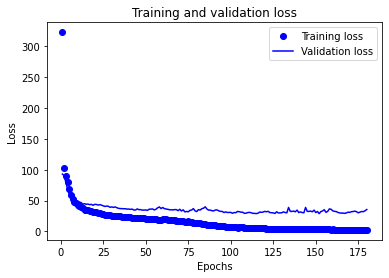

In [ ]:
# plot the losses - we will be keeping this graph
loss = model.history.history['loss']
val_loss = model.history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Predict

In [ ]:
import numpy as np
import os
import tensorflow as tf
from scipy.io import loadmat
import cv2
import matplotlib.pyplot as plt

def decode_to_boxes(output , ht , wd):
    #output : (x,x,1,5)
    #x,y,h,w

    img_ht = ht
    img_wd = wd
    threshold = 0.5
    grid_h,grid_w = output.shape[:2]
    final_boxes = []
    scores = []

    for i in range(grid_h):
        for j in range(grid_w):
            if output[i,j,0,0] > threshold:

                temp = output[i,j,0,1:5]
                
                x_unit = ((j + (temp[0]))/grid_w)*img_wd
                y_unit = ((i + (temp[1]))/grid_h)*img_ht
                width = temp[2]*img_wd*1.3
                height = temp[3]*img_ht*1.3
                
                final_boxes.append([x_unit - width/2,y_unit - height/2 ,x_unit + width/2,y_unit + height/2])
                #print(final_boxes)
                scores.append(output[i,j,0,0])
    #print(final_boxes)
    return final_boxes,scores



def iou(box1,box2):

    x1 = max(box1[0],box2[0])
    x2 = min(box1[2],box2[2])
    y1 = max(box1[1] ,box2[1])
    y2 = min(box1[3],box2[3])
    
    inter = (x2 - x1)*(y2 - y1)
    
    area1 = (box1[2] - box1[0])*(box1[3] - box1[1])
    area2 = (box2[2] - box2[0])*(box2[3] - box2[1])
    fin_area = area1 + area2 - inter
        
    iou = inter/fin_area
    
    return iou



def non_max(boxes , scores , iou_num):

    scores_sort = scores.argsort().tolist()
    keep = []
    
    while(len(scores_sort)):
        
        index = scores_sort.pop()
        keep.append(index)
        
        if(len(scores_sort) == 0):
            break
    
        iou_res = []
    
        for i in scores_sort:
            iou_res.append(iou(boxes[index] , boxes[i]))
        
        iou_res = np.array(iou_res)
        filtered_indexes = set((iou_res > iou_num).nonzero()[0])

        scores_sort = [v for (i,v) in enumerate(scores_sort) if i not in filtered_indexes]
    
    final = []
    
    for i in keep:
        final.append(boxes[i])
    
    return final


def decode(output , ht , wd , iou):
    
    
    boxes , scores = decode_to_boxes(output ,ht ,wd)
    
    boxes = non_max(boxes,np.array(scores) , iou)
    
    
    return boxes

In [ ]:
def predict_func(model , inp , iou , name):

    ans = model.predict(inp)
    #print(ans.shape)
    #np.save('Results/ans.npy',ans)
    boxes = decode(ans[0], img_w , img_h , iou)
    
    img = ((inp + 1)/2)
    img = img[0]
    #plt.imshow(img)
    #plt.show()

    #print(boxes)
    for i in boxes:

        i = [int(x) for x in i]

        img = cv2.rectangle(img , (i[0] ,i[1]) , (i[2] , i[3]) , color = (0,255,0) , thickness = 2)

    plt.imshow(img)
    plt.show()
    
    cv2.imwrite(os.path.join('Results' , str(name) + '.jpg') , img*255.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


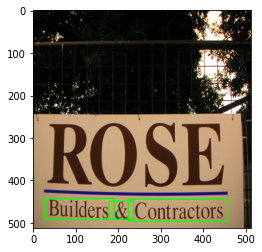

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


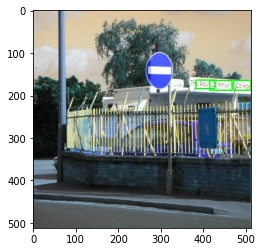

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


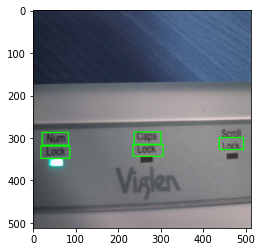

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


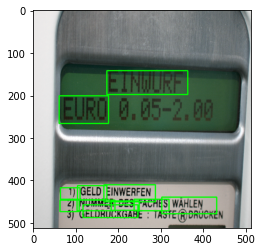

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


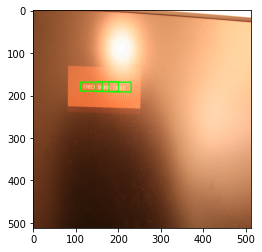

In [ ]:
model1 = load_model('/content/drive/MyDrive/AI2/text_detect_model.json')
model1.load_weights('/content/drive/MyDrive/AI2/text_detect_180.h5')
rand = np.random.randint(0,X_test.shape[0], size = 5)

for i in rand:
    
    predict_func(model1 , X_test[i:i+1] , 0.5, i)

# Testing on test dataset

/content/drive/MyDrive/AI2/Test/00_00.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


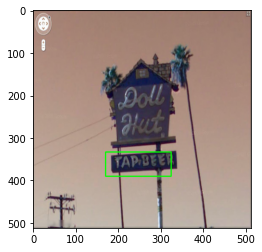

/content/drive/MyDrive/AI2/Test/01_10.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


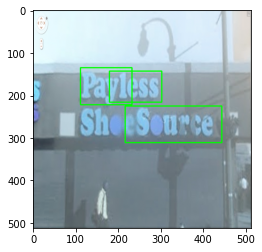

/content/drive/MyDrive/AI2/Test/00_19.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


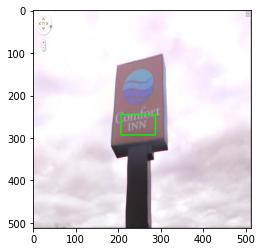

/content/drive/MyDrive/AI2/Test/03_09.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


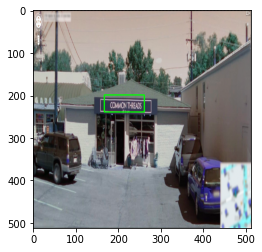

/content/drive/MyDrive/AI2/Test/03_05.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


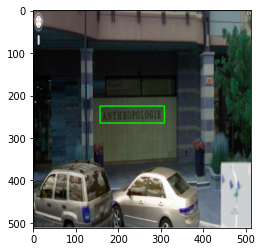

/content/drive/MyDrive/AI2/Test/03_10.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


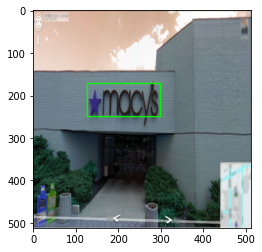

/content/drive/MyDrive/AI2/Test/03_07.jpg


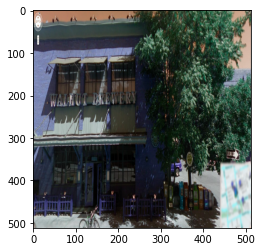

/content/drive/MyDrive/AI2/Test/03_08.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


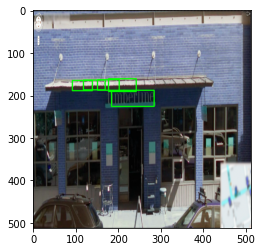

/content/drive/MyDrive/AI2/Test/03_00.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


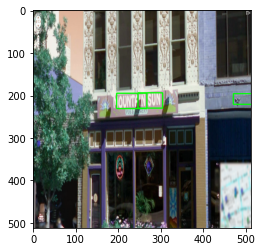

/content/drive/MyDrive/AI2/Test/03_06.jpg


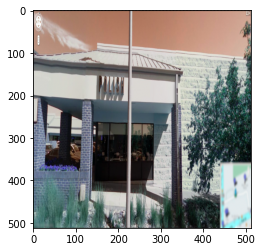

/content/drive/MyDrive/AI2/Test/03_19.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


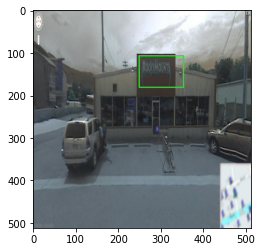

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_15.jpg


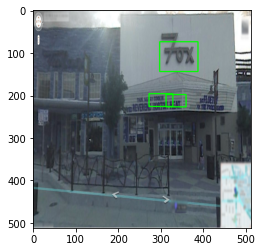

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_13.jpg


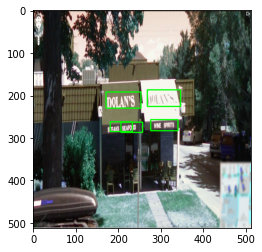

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_11.jpg


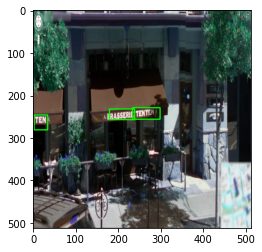

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_14.jpg


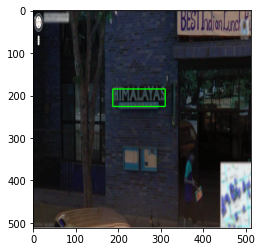

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_18.jpg


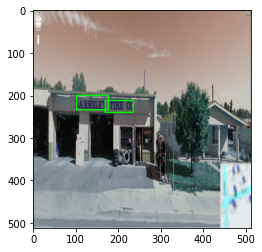

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_16.jpg


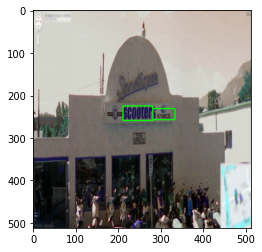

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/03_12.jpg


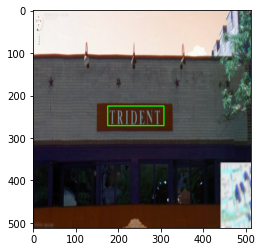

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_19.jpg


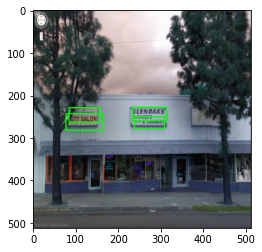

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_00.jpg


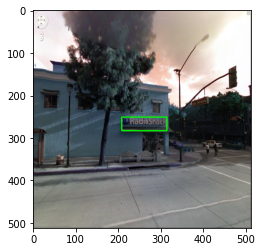

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_03.jpg


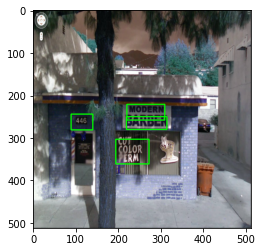

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_04.jpg


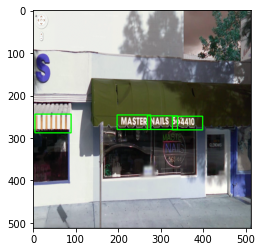

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_15.jpg


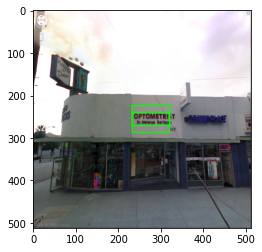

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_07.jpg


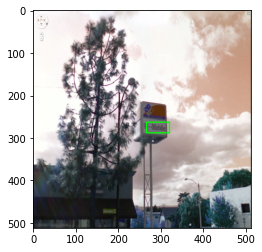

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_06.jpg


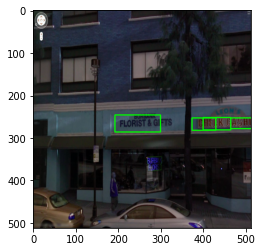

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_05.jpg


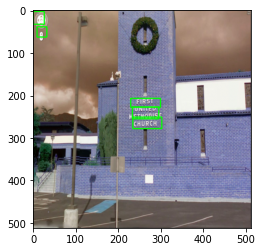

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_11.jpg


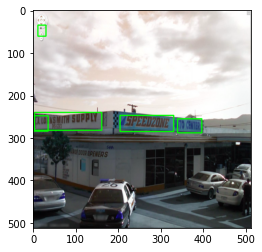

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_13.jpg


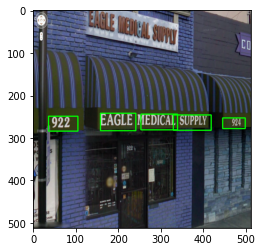

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_01.jpg


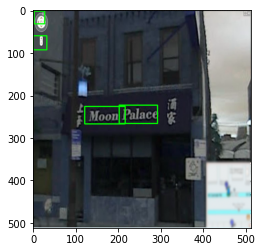

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_14.jpg


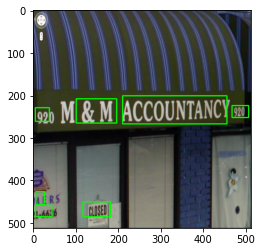

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_17.jpg


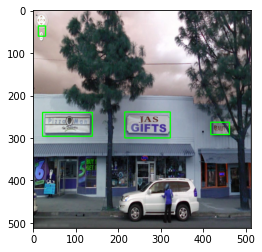

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_12.jpg


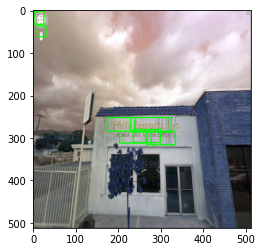

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_02.jpg


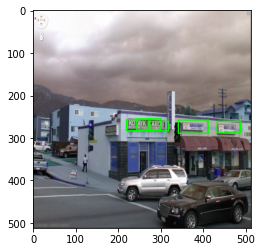

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_03.jpg


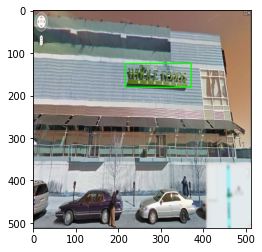

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_01.jpg


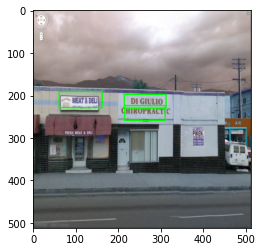

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_02.jpg


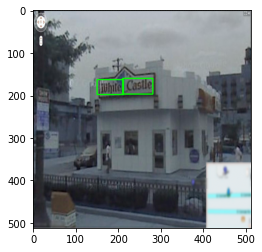

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_00.jpg


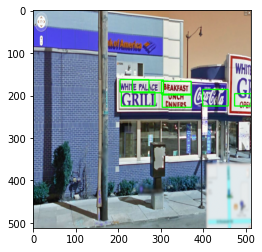

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_18.jpg


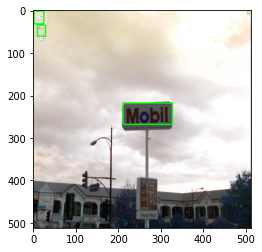

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/04_16.jpg


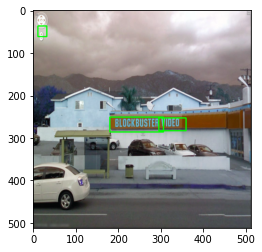

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_13.jpg


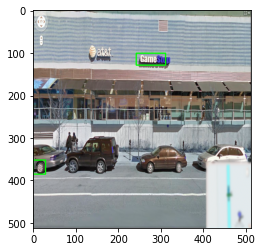

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_07.jpg


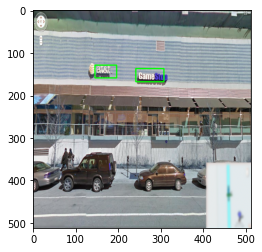

/content/drive/MyDrive/AI2/Test/05_11.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


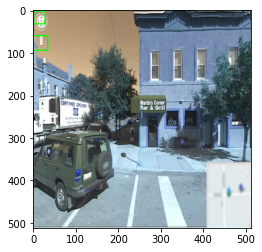

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_05.jpg


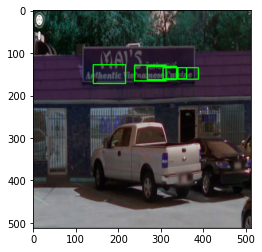

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_15.jpg


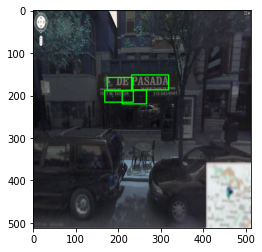

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_02.jpg


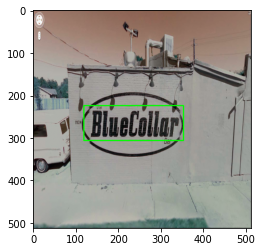

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_18.jpg


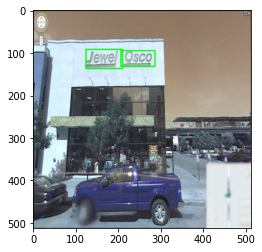

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_06.jpg


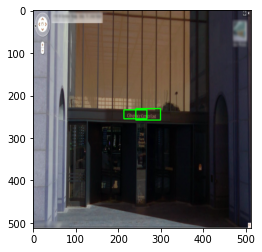

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_08.jpg


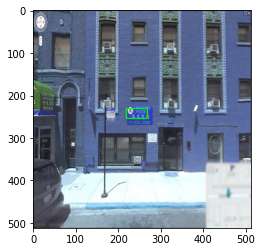

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_17.jpg


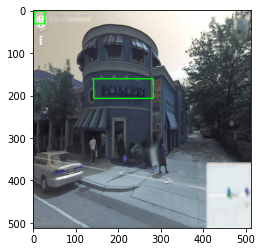

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_16.jpg


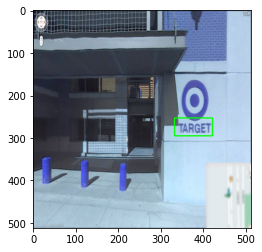

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_04.jpg


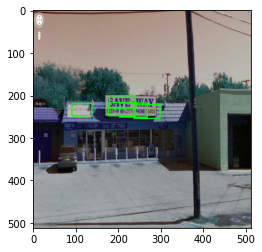

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_04.jpg


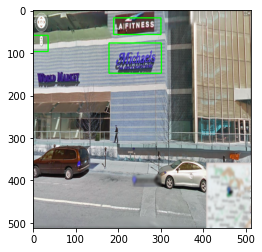

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_19.jpg


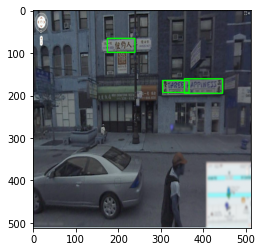

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_12.jpg


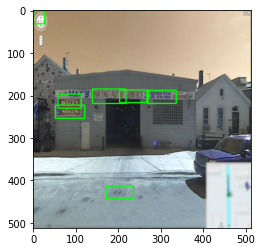

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_14.jpg


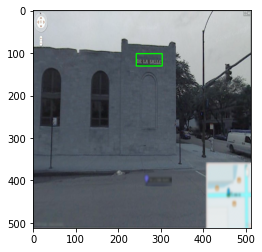

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_10.jpg


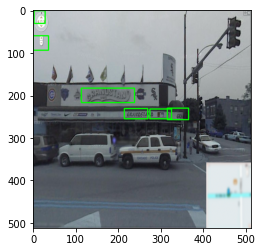

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_01.jpg


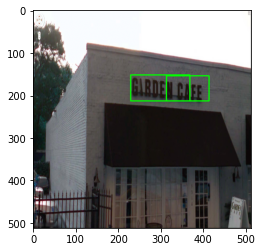

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_03.jpg


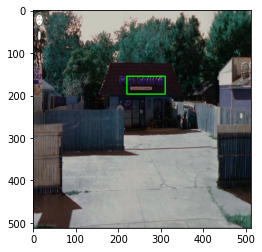

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_00.jpg


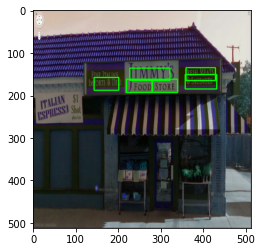

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_09.jpg


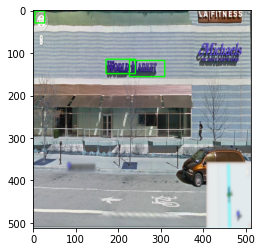

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_06.jpg


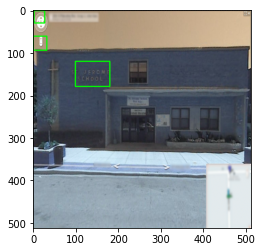

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/05_05.jpg


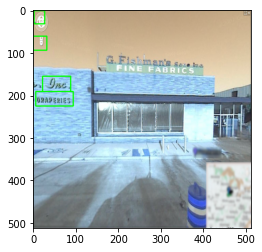

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_12.jpg


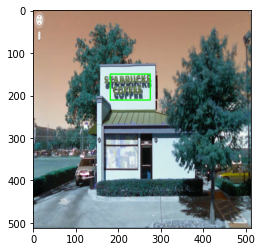

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_15.jpg


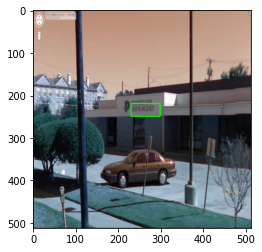

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_16.jpg


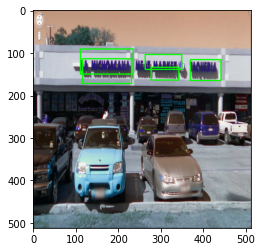

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_08.jpg


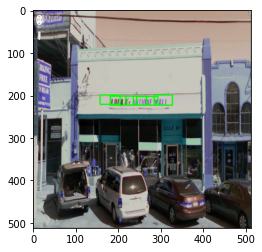

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_01.jpg


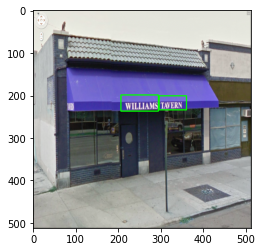

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_03.jpg


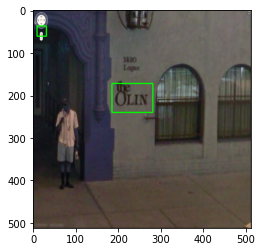

/content/drive/MyDrive/AI2/Test/06_11.jpg


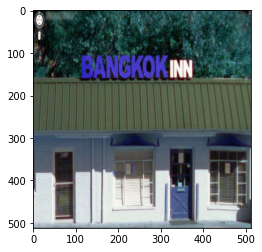

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_18.jpg


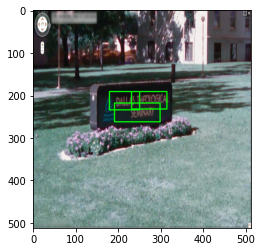

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_14.jpg


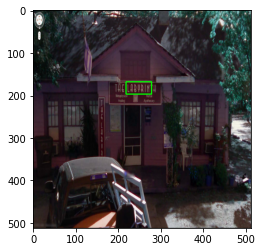

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_17.jpg


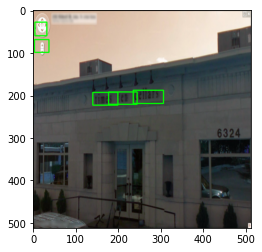

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_04.jpg


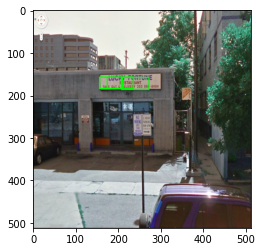

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_00.jpg


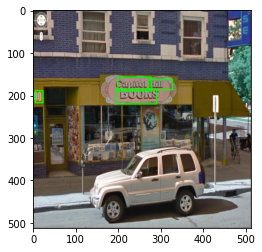

/content/drive/MyDrive/AI2/Test/06_10.jpg


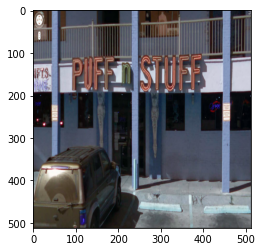

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_06.jpg


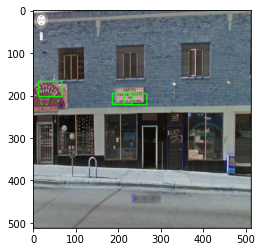

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_02.jpg


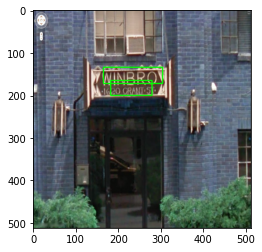

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/06_13.jpg


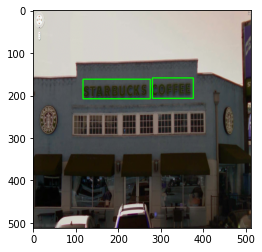

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_05.jpg


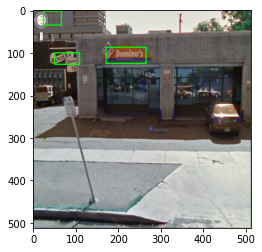

/content/drive/MyDrive/AI2/Test/07_13.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


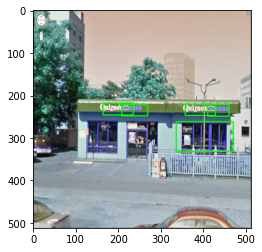

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_10.jpg


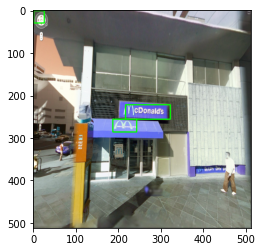

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_14.jpg


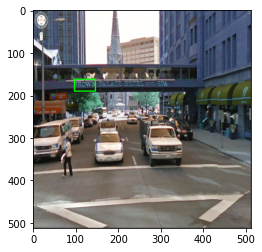

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_17.jpg


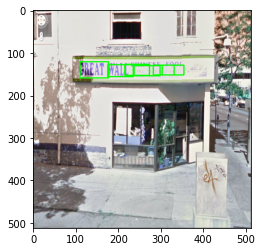

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_19.jpg


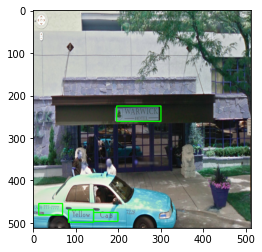

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_16.jpg


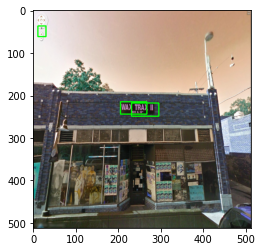

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_08.jpg


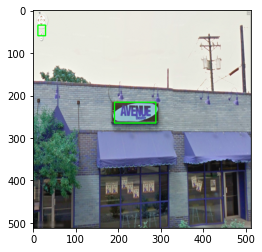

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_12.jpg


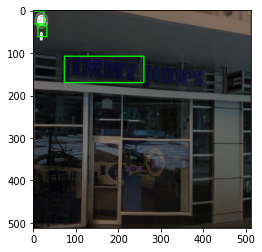

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_07.jpg


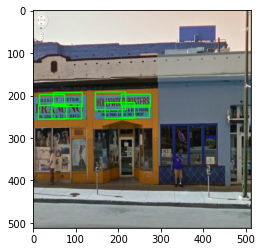

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_11.jpg


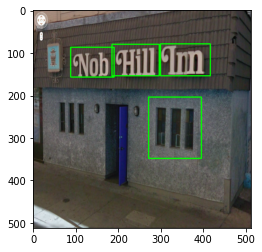

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_09.jpg


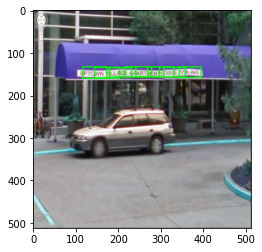

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/07_15.jpg


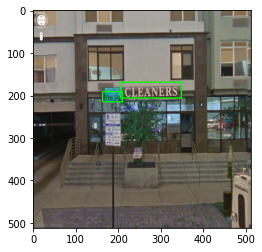

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/08_00.jpg


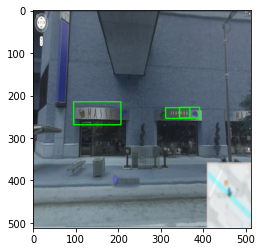

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


/content/drive/MyDrive/AI2/Test/img_88.jpeg


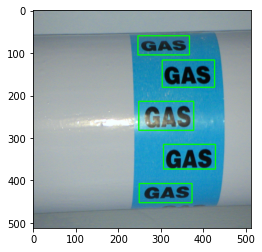

In [ ]:
path = '/content/drive/MyDrive/AI2/Test/'
for i in os.listdir(path):
    img = cv2.imread(path+i)
    #plt.imshow(img)
    print(path+i)
    img = cv2.resize(img,(512,512))
    img = (img - 127.5)/127.5
    predict_func(model1 , np.expand_dims(img,axis= 0) , 0.5 , 'sample')

# Text Segmentation - Split words into separate image

In [ ]:
def splitwords(model , inp , iou , name):

    save_path = '/content/drive/MyDrive/AI2/SegmentedWords/'

    ans = model.predict(inp)
    #print(ans.shape)
    #np.save('Results/ans.npy',ans)
    boxes = decode(ans[0], img_w , img_h , iou)
    word_count = 0 
    img = ((inp + 1)/2)
    img = img[0]
    plt.imshow(img)
    plt.show()

    #print(boxes)
    for i in boxes:
        i = [int(x) for x in i]

        print(i[0]," ",i[1]," ",i[2]," ",i[3])
        crop_img = img[i[1]:i[3], i[0]:i[2]]
        cv2.imwrite(save_path + str(name) + '_' + str(word_count) + '.jpg' , crop_img*255.0)
        word_count += 1
        plt.imshow(crop_img)
        plt.show()

In [ ]:
for i in range(0,5):
    img = cv2.resize(img,(512,512))
    img = (img - 127.5)/127.5
    splitwords(model1 , np.expand_dims(img,axis= 0) , 0.5 , 'sample')

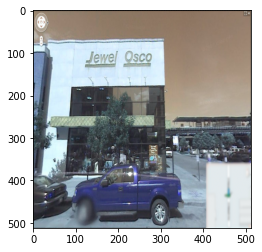

124   92   210   137


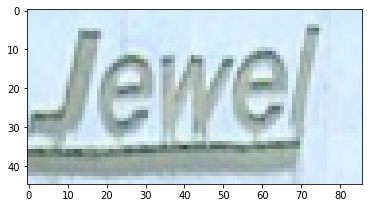

206   95   286   132


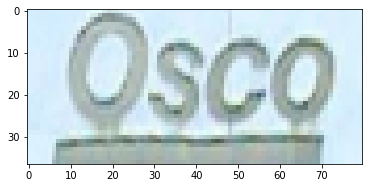

In [ ]:
img = cv2.imread('/content/drive/MyDrive/AI2/Test/05_18.jpg')
img = cv2.resize(img,(512,512))
img = (img - 127.5)/127.5
splitwords(model1 , np.expand_dims(img,axis= 0) , 0.5 , 'sample')

/content/drive/MyDrive/AI2/Test/00_00.jpg


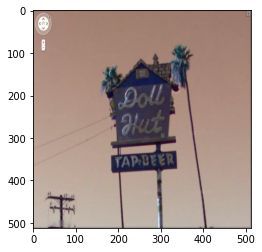

170   333   324   390


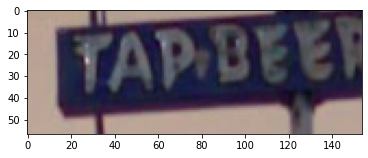

/content/drive/MyDrive/AI2/Test/01_10.jpg


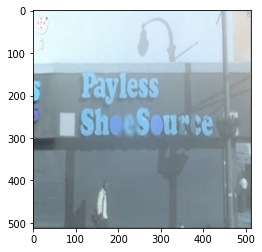

216   225   443   311


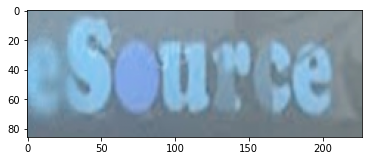

179   143   302   216


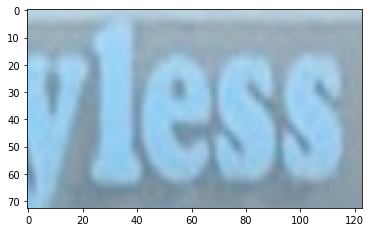

111   135   232   222


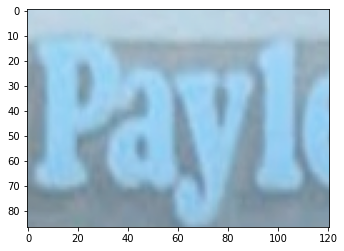

/content/drive/MyDrive/AI2/Test/00_19.jpg


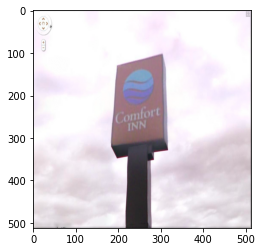

206   245   287   293


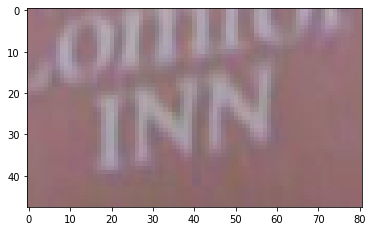

/content/drive/MyDrive/AI2/Test/03_09.jpg


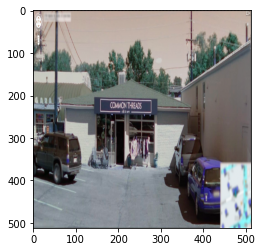

167   199   261   239


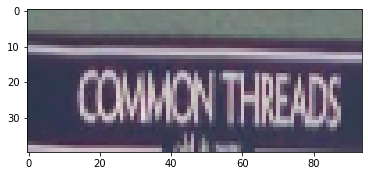

/content/drive/MyDrive/AI2/Test/03_05.jpg


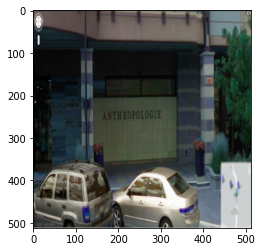

157   225   308   265


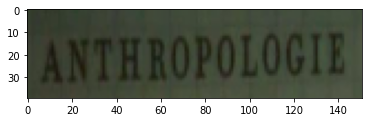

/content/drive/MyDrive/AI2/Test/03_10.jpg


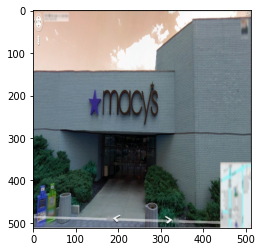

127   172   299   250


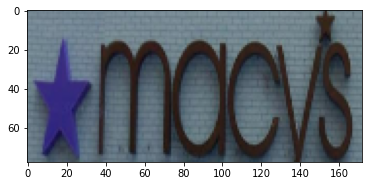

/content/drive/MyDrive/AI2/Test/03_07.jpg


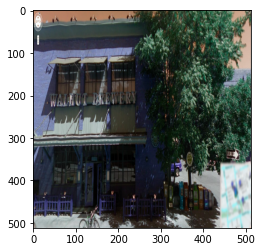

/content/drive/MyDrive/AI2/Test/03_08.jpg


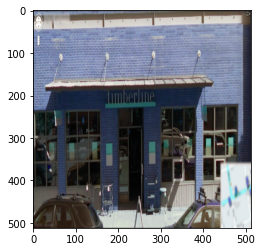

118   164   169   187


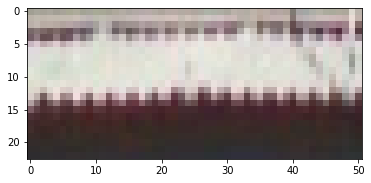

184   188   284   226


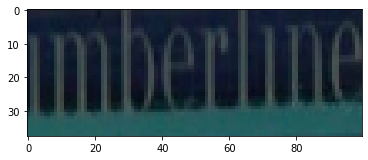

177   161   242   191


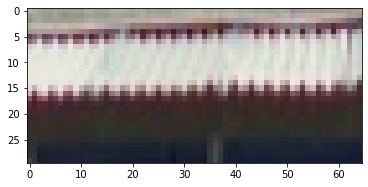

151   163   202   188


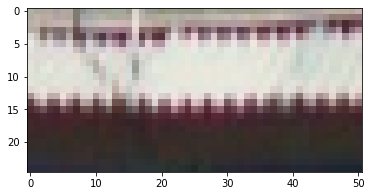

92   165   139   189


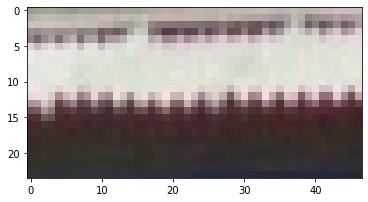

/content/drive/MyDrive/AI2/Test/03_00.jpg


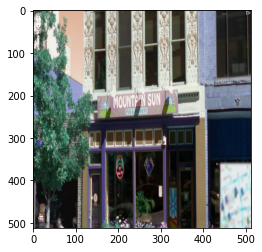

196   195   267   231


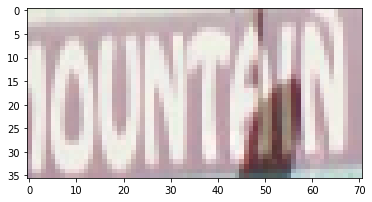

470   196   513   221


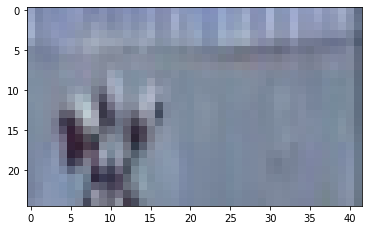

246   194   304   230


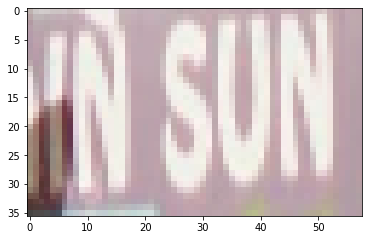

/content/drive/MyDrive/AI2/Test/03_06.jpg


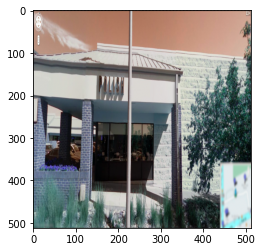

/content/drive/MyDrive/AI2/Test/03_19.jpg


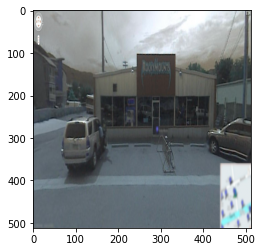

249   107   353   181


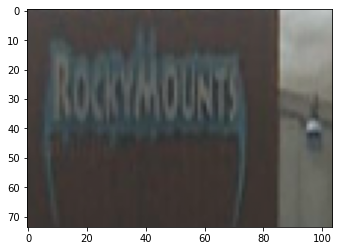

/content/drive/MyDrive/AI2/Test/03_15.jpg


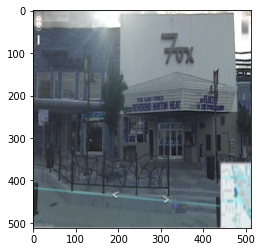

297   74   387   144


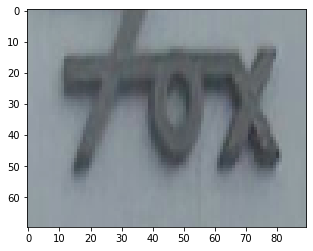

312   198   359   227


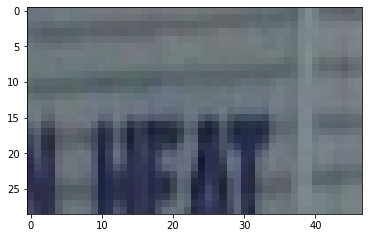

272   196   328   226


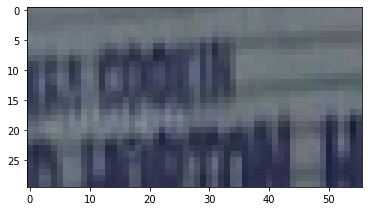

/content/drive/MyDrive/AI2/Test/03_13.jpg


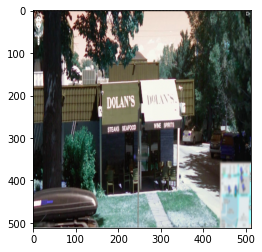

171   192   253   230


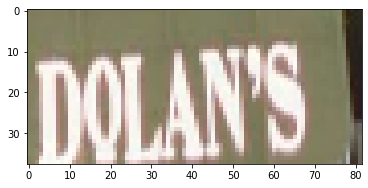

206   263   257   287


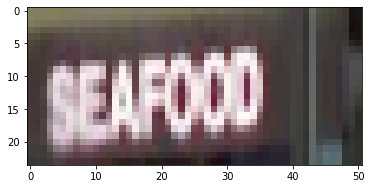

268   187   346   226


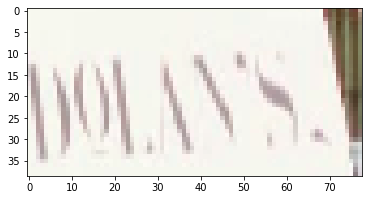

276   257   340   283


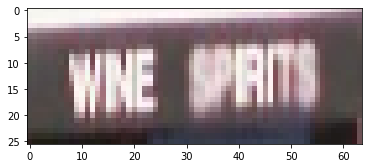

181   262   233   285


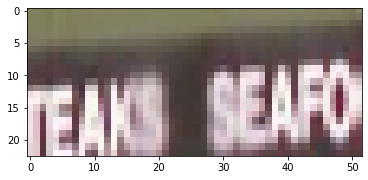

/content/drive/MyDrive/AI2/Test/03_11.jpg


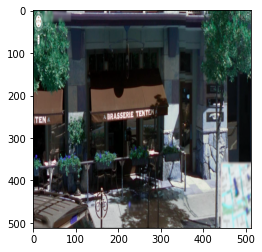

179   232   238   257


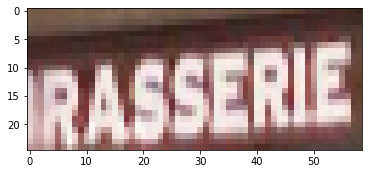

233   229   298   256


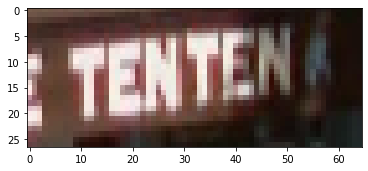

2   246   34   281


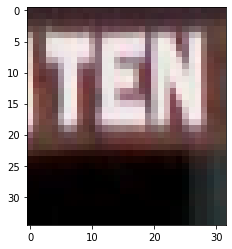

/content/drive/MyDrive/AI2/Test/03_14.jpg


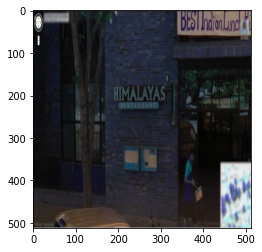

187   185   310   226


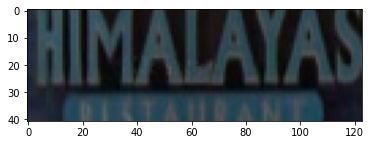

/content/drive/MyDrive/AI2/Test/03_18.jpg


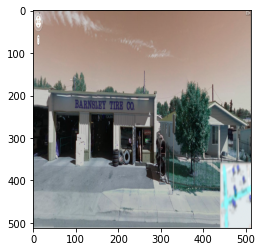

102   200   176   234


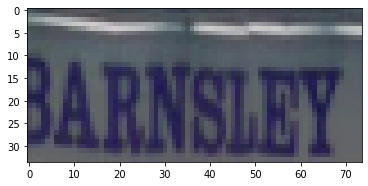

169   212   235   240


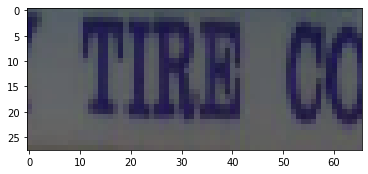

/content/drive/MyDrive/AI2/Test/03_16.jpg


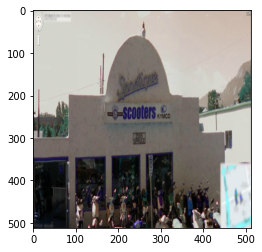

211   225   281   259


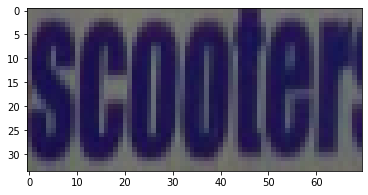

281   231   333   257


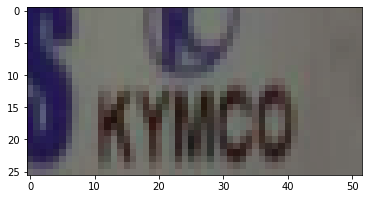

/content/drive/MyDrive/AI2/Test/03_12.jpg


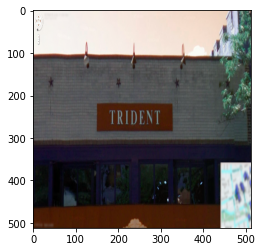

175   225   307   271


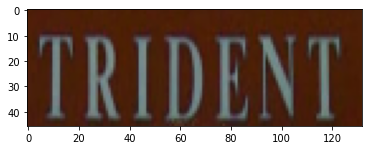

/content/drive/MyDrive/AI2/Test/04_19.jpg


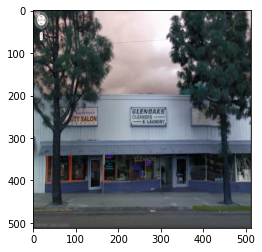

233   228   313   260


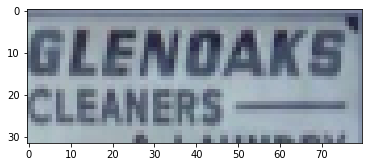

84   229   157   263


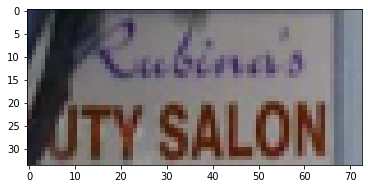

77   243   165   282


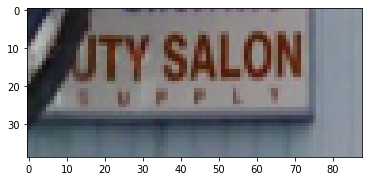

238   250   308   278


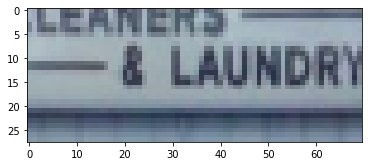

/content/drive/MyDrive/AI2/Test/04_00.jpg


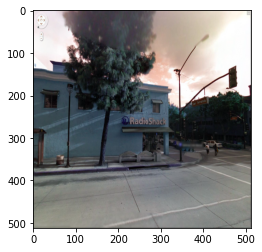

208   251   314   283


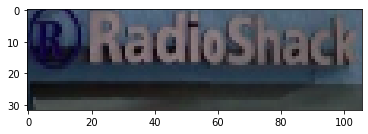

/content/drive/MyDrive/AI2/Test/04_03.jpg


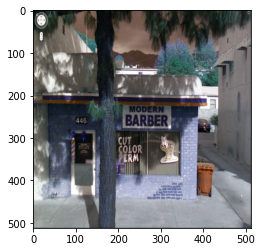

220   221   309   258


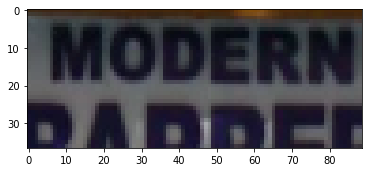

219   250   314   280


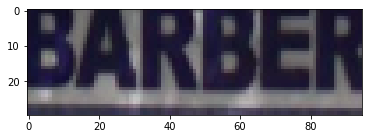

194   303   272   361


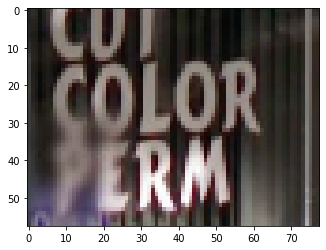

89   244   140   281


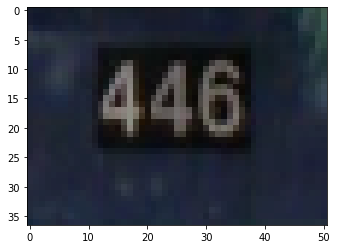

/content/drive/MyDrive/AI2/Test/04_04.jpg


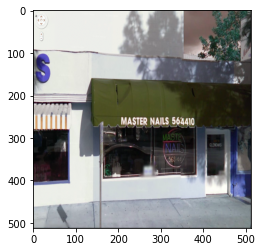

268   248   339   280


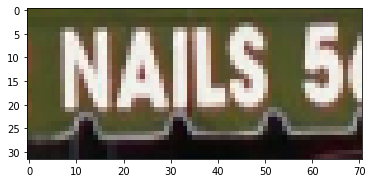

197   246   276   280


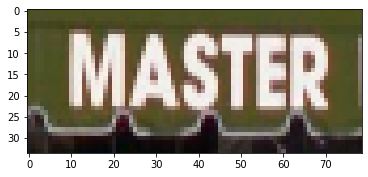

4   244   89   288


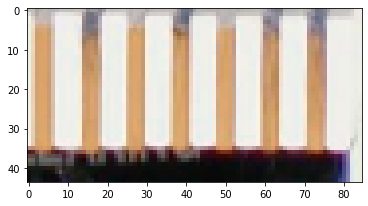

327   249   398   281


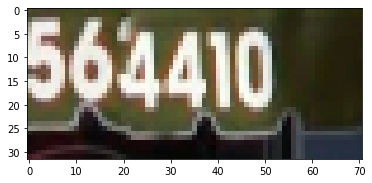

/content/drive/MyDrive/AI2/Test/04_15.jpg


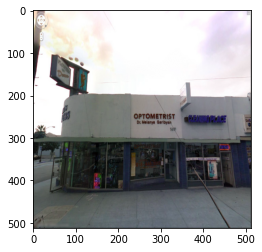

232   224   321   271


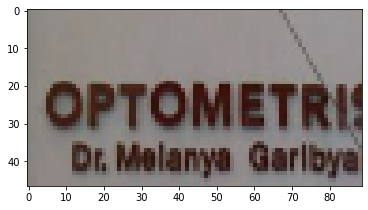

233   240   320   287


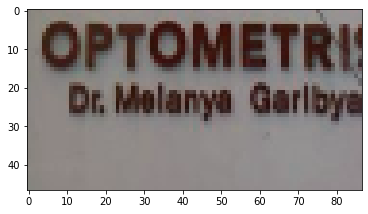

/content/drive/MyDrive/AI2/Test/04_07.jpg


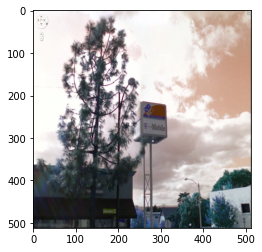

266   263   320   288


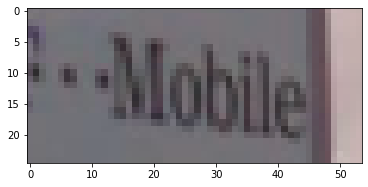

/content/drive/MyDrive/AI2/Test/04_06.jpg


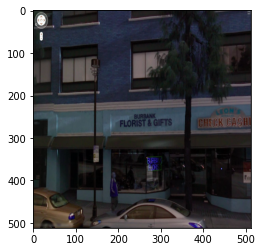

399   252   464   281


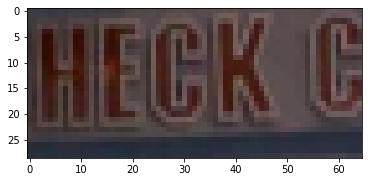

192   246   299   286


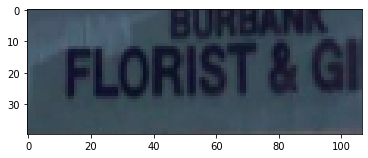

464   253   517   278


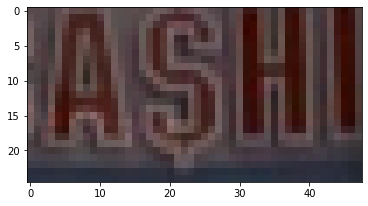

373   253   429   282


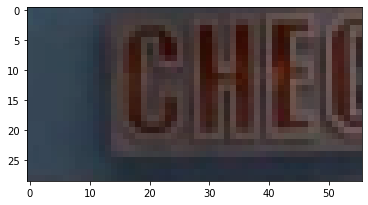

/content/drive/MyDrive/AI2/Test/04_05.jpg


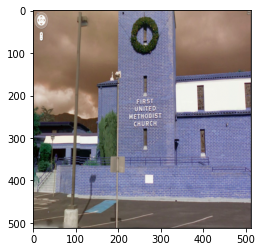

234   251   302   278


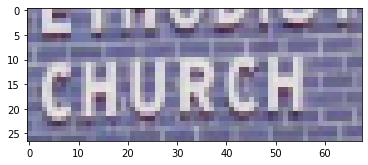

233   227   295   255


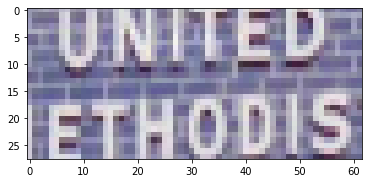

229   207   299   228


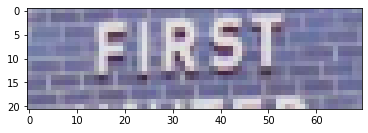

9   39   32   63


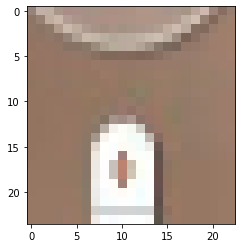

0   3   26   33


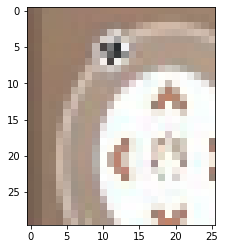

/content/drive/MyDrive/AI2/Test/04_13.jpg


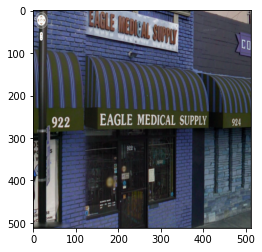

253   244   339   281


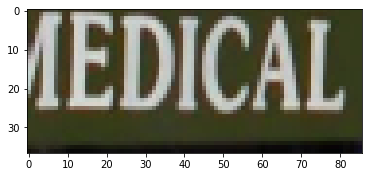

158   242   241   283


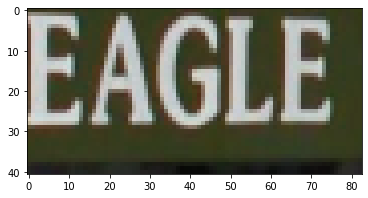

329   246   418   282


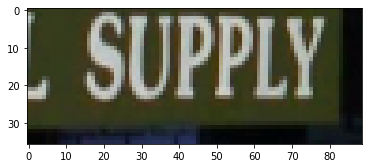

36   249   105   284


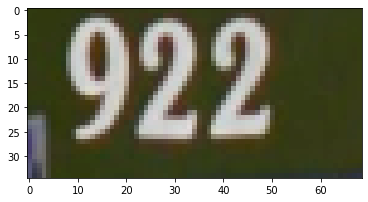

445   253   498   278


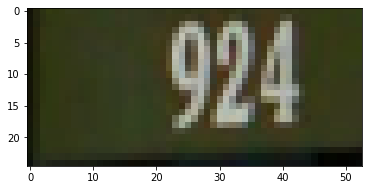

/content/drive/MyDrive/AI2/Test/05_01.jpg


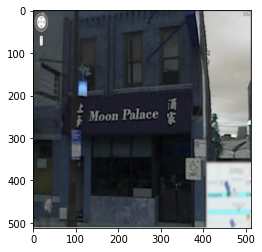

121   226   216   267


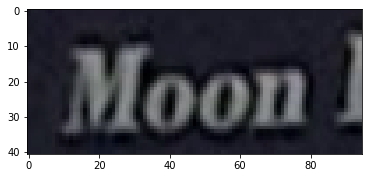

202   223   292   266


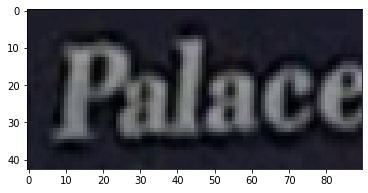

0   60   32   93


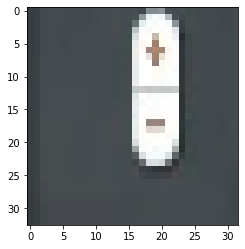

2   2   27   32


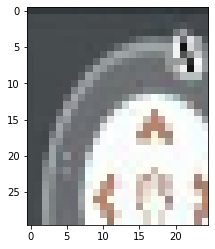

/content/drive/MyDrive/AI2/Test/04_14.jpg


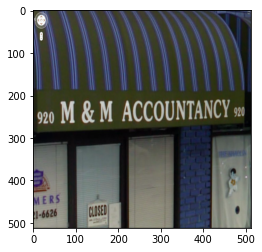

210   201   455   267


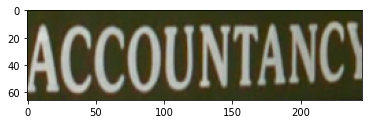

101   208   196   265


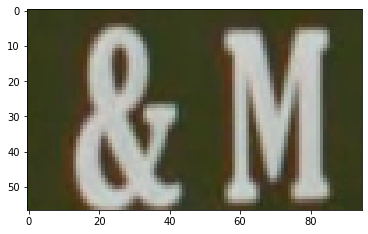

117   450   182   485


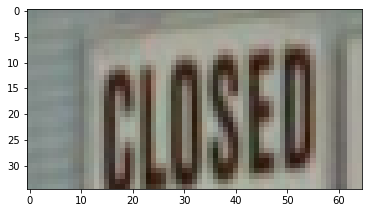

467   224   506   252


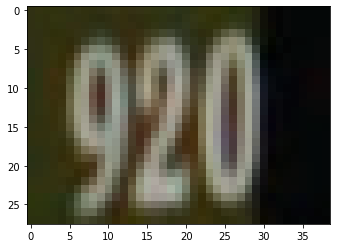

5   229   38   261


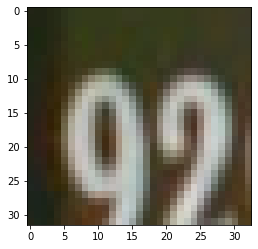

5   458   44   485


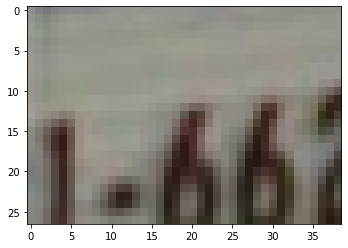

6   426   26   457


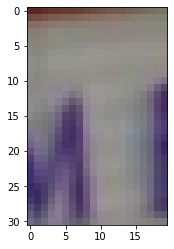

/content/drive/MyDrive/AI2/Test/04_17.jpg


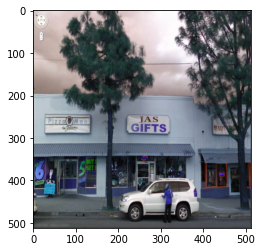

22   240   139   296


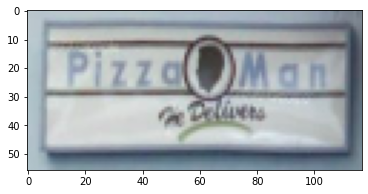

215   239   322   300


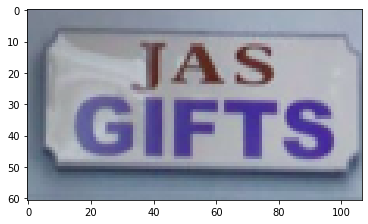

12   37   29   61


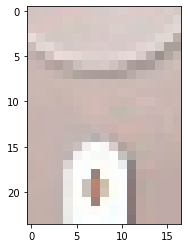

417   263   461   292


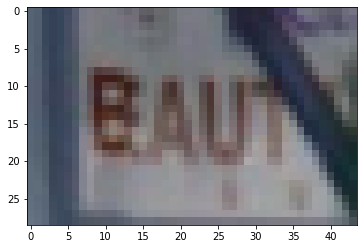

/content/drive/MyDrive/AI2/Test/04_12.jpg


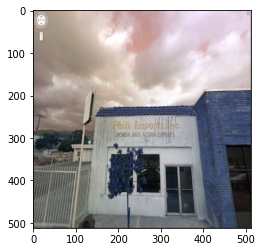

174   252   239   284


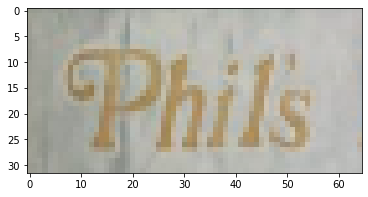

203   284   277   312


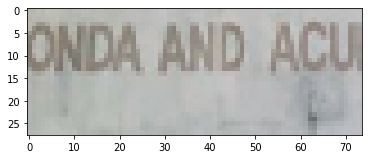

229   252   324   286


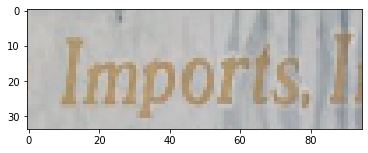

267   284   334   316


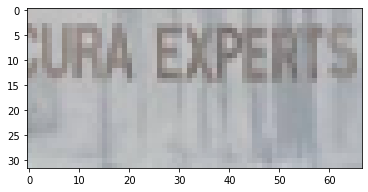

10   37   30   62


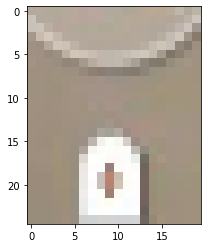

235   280   299   311


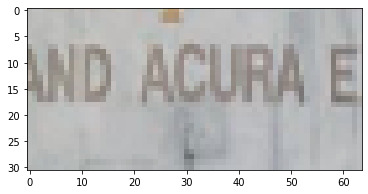

2   3   25   33


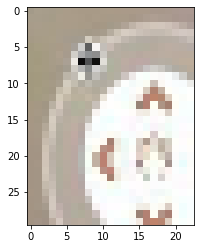

/content/drive/MyDrive/AI2/Test/04_02.jpg


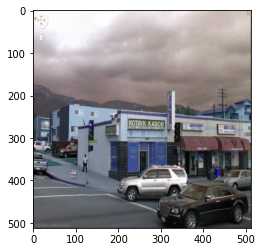

432   261   487   288


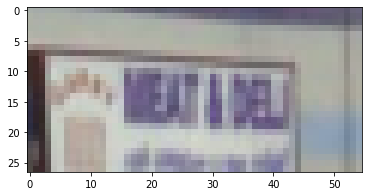

219   257   274   283


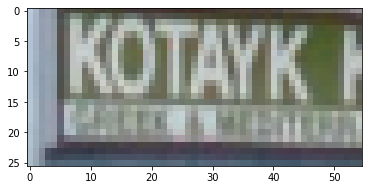

341   258   411   289


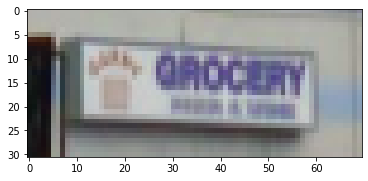

243   255   300   281


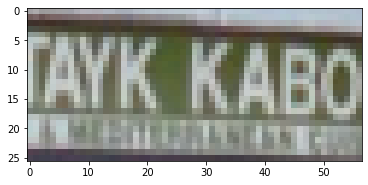

270   261   318   283


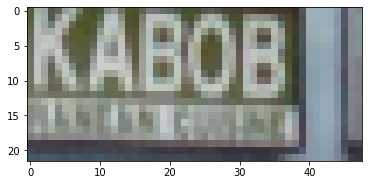

/content/drive/MyDrive/AI2/Test/05_03.jpg


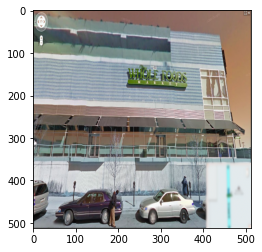

217   125   371   181


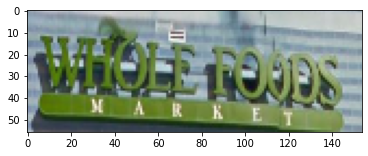

/content/drive/MyDrive/AI2/Test/04_01.jpg


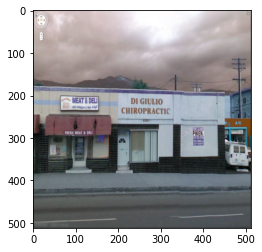

215   224   310   259


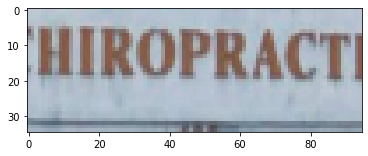

61   191   162   229


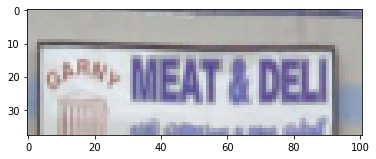

214   198   312   230


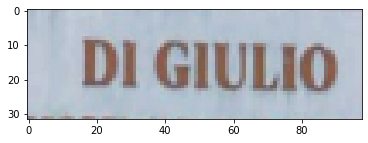

/content/drive/MyDrive/AI2/Test/05_02.jpg


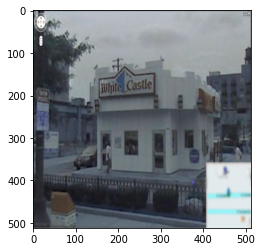

150   163   212   198


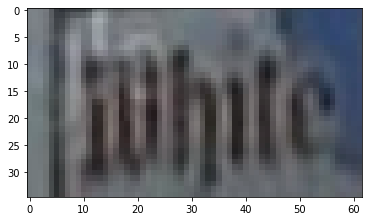

210   160   281   197


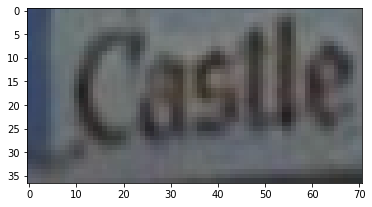

/content/drive/MyDrive/AI2/Test/05_00.jpg


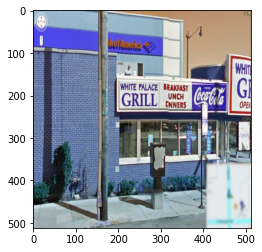

301   167   371   197


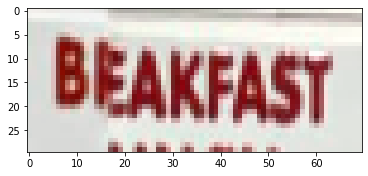

303   199   372   228


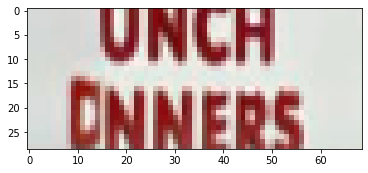

207   192   286   225


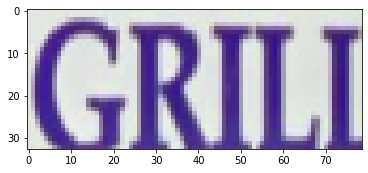

233   164   306   194


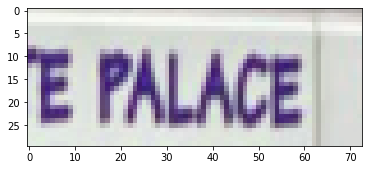

204   163   272   192


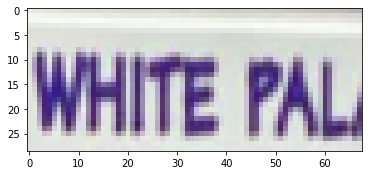

473   196   512   225


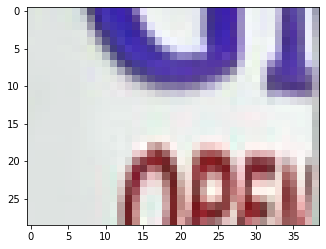

398   186   458   225


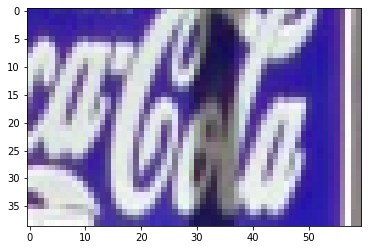

/content/drive/MyDrive/AI2/Test/04_18.jpg


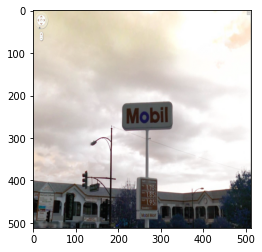

211   218   327   268


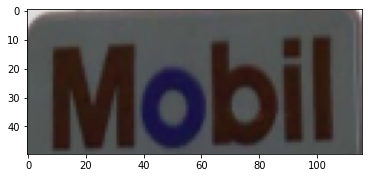

10   35   29   61


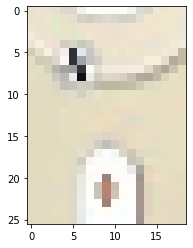

2   2   25   32


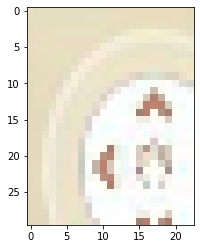

/content/drive/MyDrive/AI2/Test/04_16.jpg


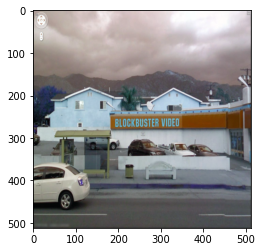

180   251   306   286


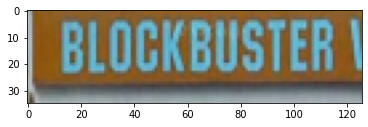

295   253   359   283


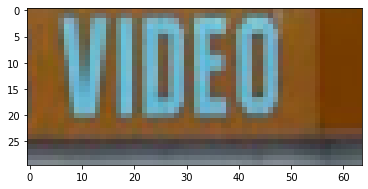

11   37   32   62


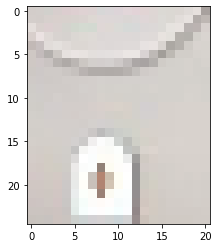

/content/drive/MyDrive/AI2/Test/05_13.jpg


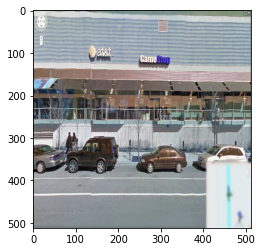

242   101   311   129


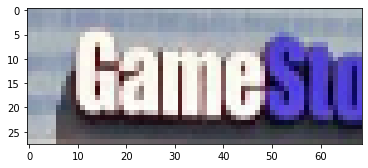

0   352   29   385


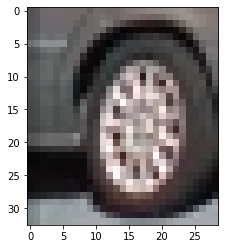

/content/drive/MyDrive/AI2/Test/05_07.jpg


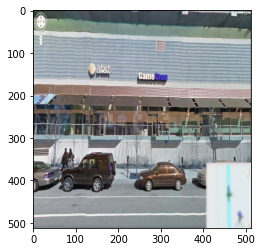

241   137   307   168


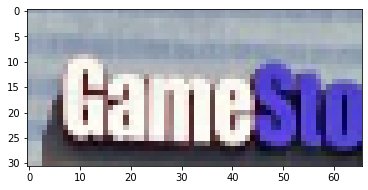

145   129   196   159


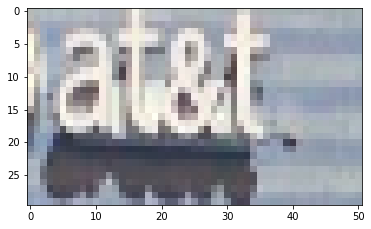

/content/drive/MyDrive/AI2/Test/06_05.jpg


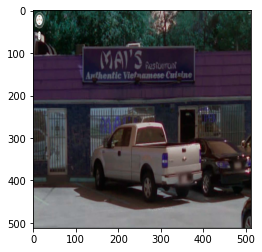

305   135   360   161


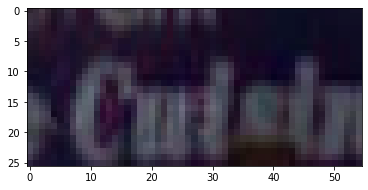

268   132   337   163


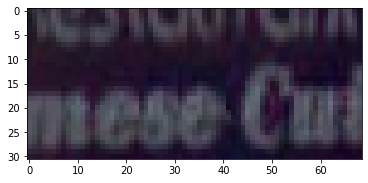

141   128   217   172


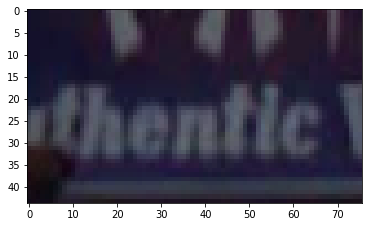

340   135   388   162


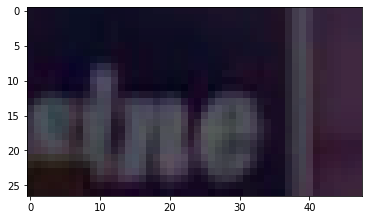

238   129   312   166


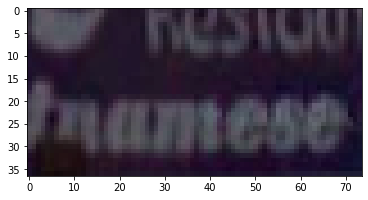

/content/drive/MyDrive/AI2/Test/05_15.jpg


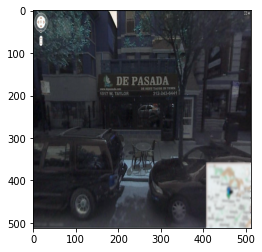

231   152   318   187


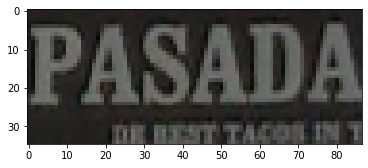

168   188   235   216


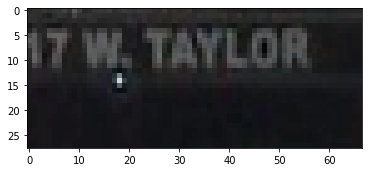

174   158   234   189


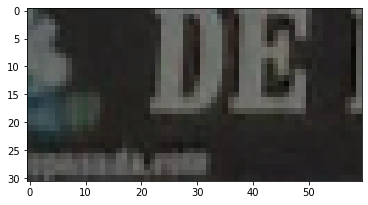

209   188   266   220


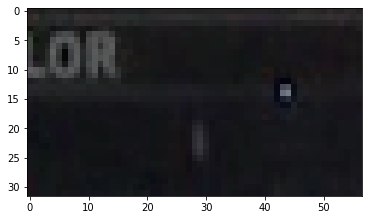

/content/drive/MyDrive/AI2/Test/06_02.jpg


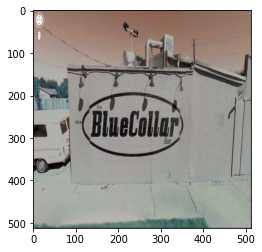

119   224   353   306


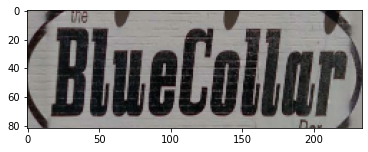

/content/drive/MyDrive/AI2/Test/05_18.jpg


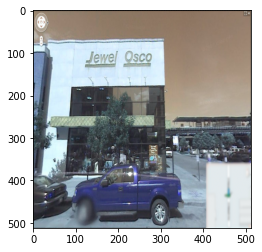

124   92   210   137


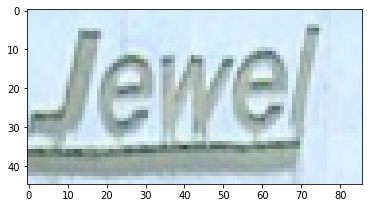

206   95   286   132


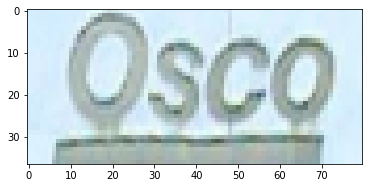

/content/drive/MyDrive/AI2/Test/06_06.jpg


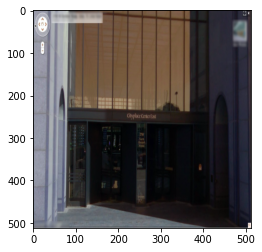

213   234   267   255


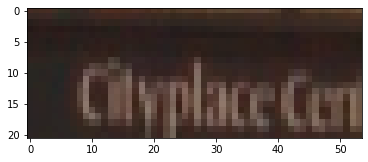

241   231   299   258


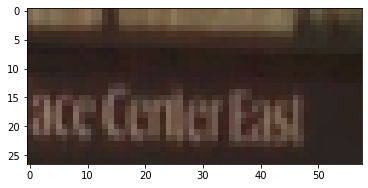

/content/drive/MyDrive/AI2/Test/05_08.jpg


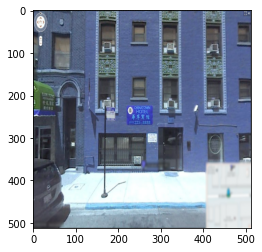

219   231   268   254


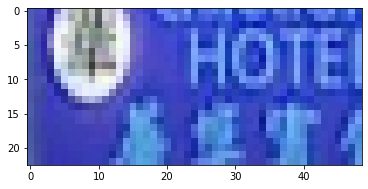

/content/drive/MyDrive/AI2/Test/05_17.jpg


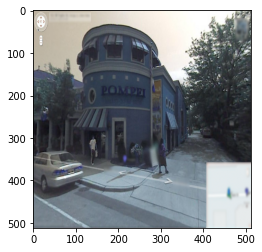

142   161   282   207


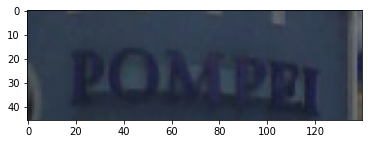

2   2   27   32


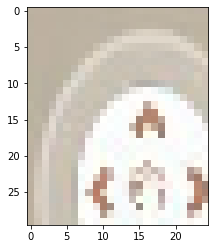

/content/drive/MyDrive/AI2/Test/05_16.jpg


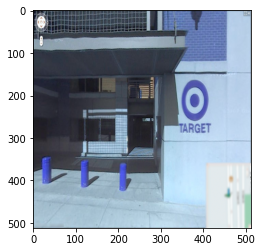

332   253   421   295


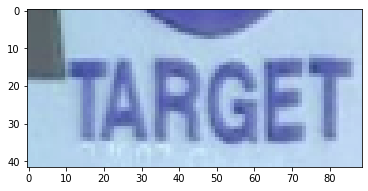

/content/drive/MyDrive/AI2/Test/06_04.jpg


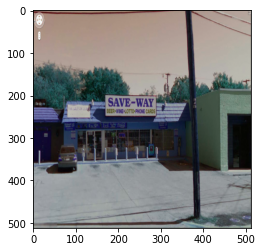

179   201   240   230


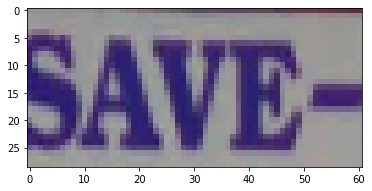

91   219   138   248


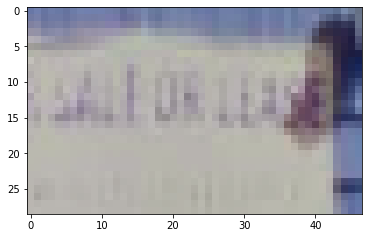

203   218   268   251


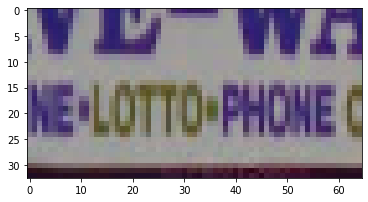

177   217   240   248


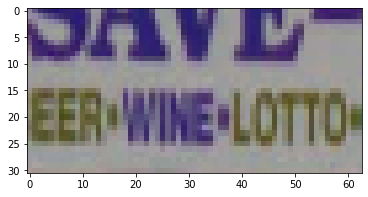

236   222   298   254


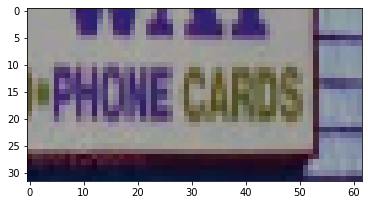

/content/drive/MyDrive/AI2/Test/05_19.jpg


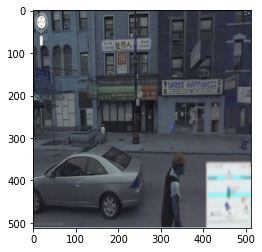

174   66   239   99


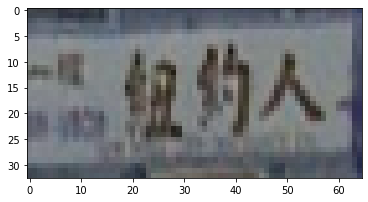

304   165   366   193


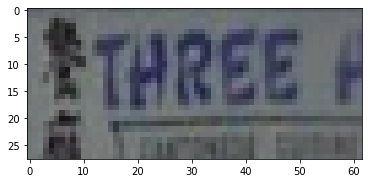

355   161   445   195


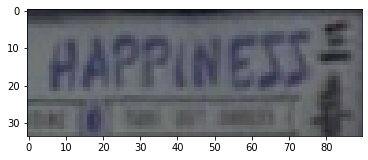

/content/drive/MyDrive/AI2/Test/05_12.jpg


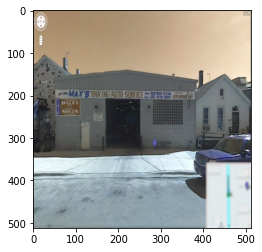

203   187   270   217


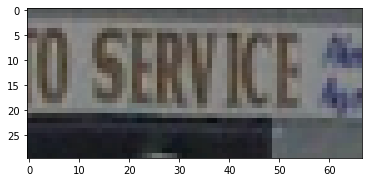

52   223   121   254


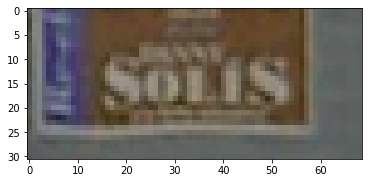

139   185   218   219


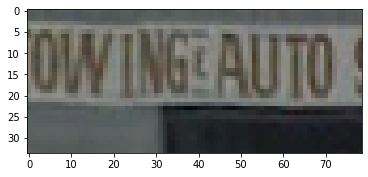

173   413   235   443


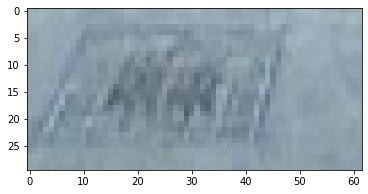

267   188   336   219


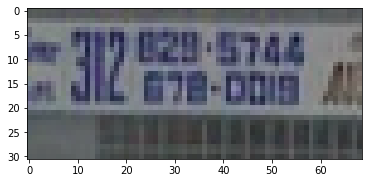

58   197   113   230


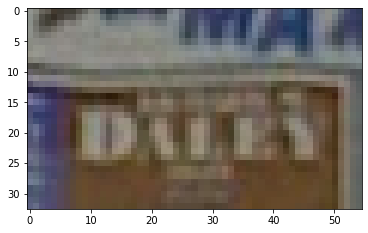

1   2   27   32


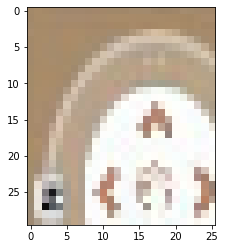

/content/drive/MyDrive/AI2/Test/05_14.jpg


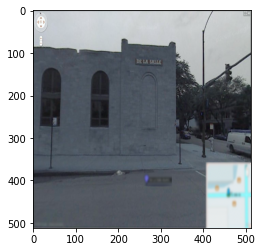

242   102   303   131


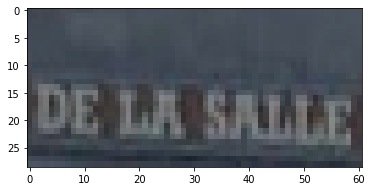

/content/drive/MyDrive/AI2/Test/06_01.jpg


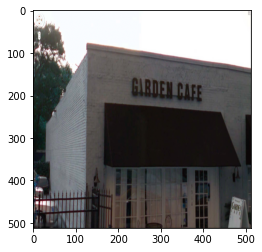

229   152   368   213


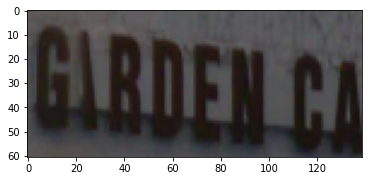

313   154   413   213


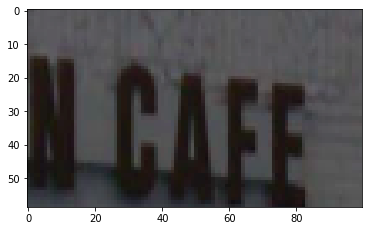

/content/drive/MyDrive/AI2/Test/06_03.jpg


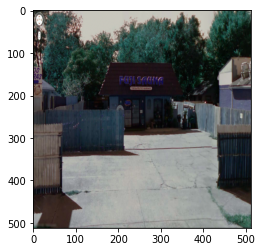

220   155   310   197


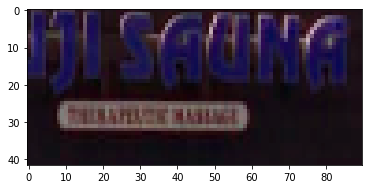

/content/drive/MyDrive/AI2/Test/06_00.jpg


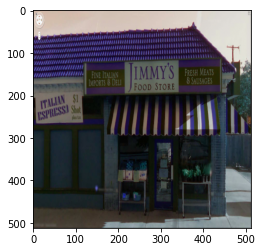

279   162   339   193


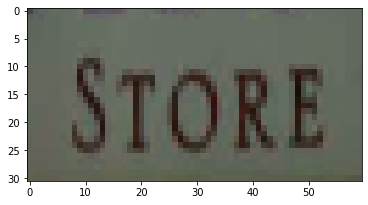

143   158   201   188


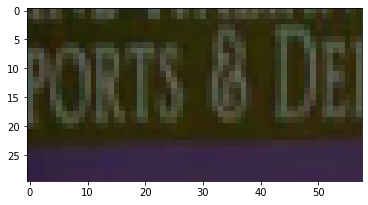

227   136   321   165


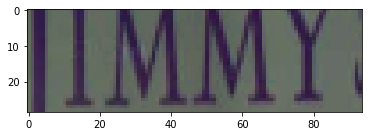

219   162   280   193


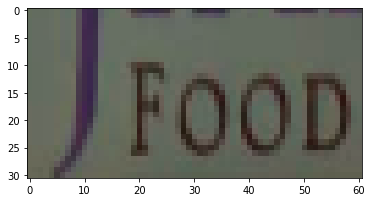

357   151   431   185


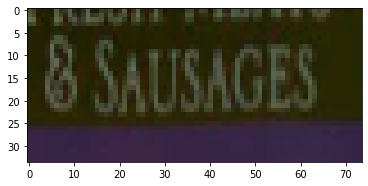

359   135   428   165


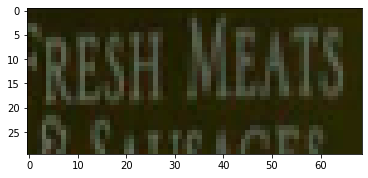

/content/drive/MyDrive/AI2/Test/05_09.jpg


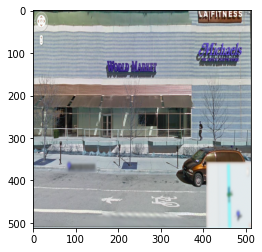

226   118   309   156


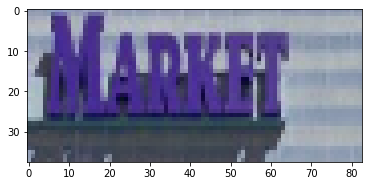

171   115   240   149


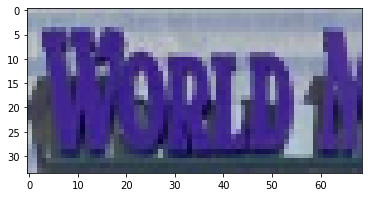

4   2   27   30


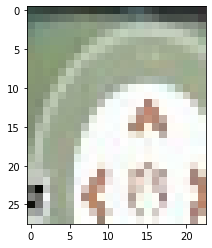

/content/drive/MyDrive/AI2/Test/05_06.jpg


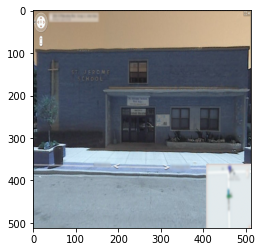

99   120   180   179


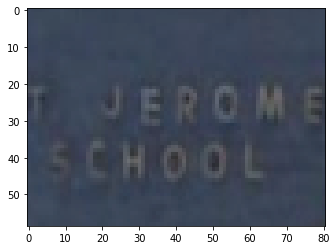

0   61   32   94


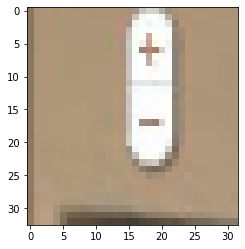

2   1   27   30


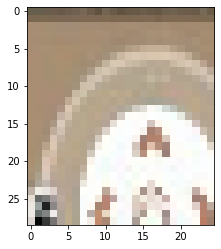

/content/drive/MyDrive/AI2/Test/05_05.jpg


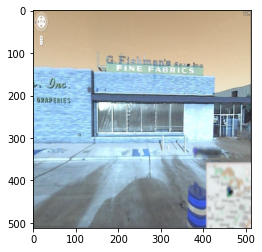

6   191   94   225


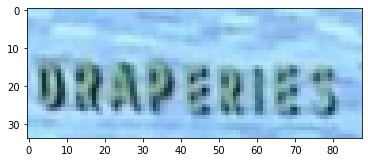

-1   61   32   94


error: ignored

In [ ]:
path = '/content/drive/MyDrive/AI2/Test/'
for i in os.listdir(path):
    img = cv2.imread(path+i)
    #plt.imshow(img)
    print(path+i)
    img = cv2.resize(img,(512,512))
    img = (img - 127.5)/127.5
    splitwords(model1 , np.expand_dims(img,axis= 0) , 0.5 , i)

# Text Recognition
### Detect characters in the segmented words

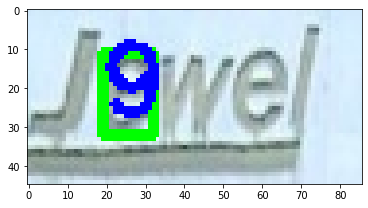

Words: 9


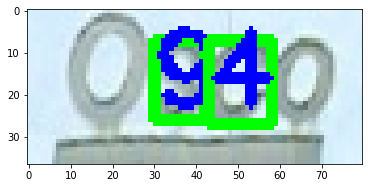

Words: 94


In [ ]:
# Import the necessary packages
import argparse
import cv2
import numpy as np
from keras.models import load_model
from keras.preprocessing.image import img_to_array
import functools

# Read the image and convert to grayscale
path = '/content/drive/MyDrive/AI2/Test/SegmentedWords/'
for i in os.listdir(path):
    image = cv2.imread(path+i)
    plt.imshow(image)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blurring and thresholding 
    # to reveal the characters
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(blurred, 255,
      cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 45, 15)

    # Perform connected components analysis on the thresholded images and
    # initialize the mask to hold only the components we are interested in
    _, labels = cv2.connectedComponents(thresh)
    mask = np.zeros(thresh.shape, dtype="uint8")

    # Set lower bound and upper bound criteria for characters
    total_pixels = image.shape[0] * image.shape[1]
    lower = total_pixels // 70 # heuristic param, can be fine tuned if necessary
    upper = total_pixels // 20 # heuristic param, can be fine tuned if necessary

    # Loop over the unique components
    for (i, label) in enumerate(np.unique(labels)):
      # If this is the background label, ignore it
      if label == 0:
        continue
    
      # Otherwise, construct the label mask to display only connected component
      # for the current label
      labelMask = np.zeros(thresh.shape, dtype="uint8")
      labelMask[labels == label] = 255
      numPixels = cv2.countNonZero(labelMask)
    
      # If the number of pixels in the component is between lower bound and upper bound, 
      # add it to our mask
      if numPixels > lower and numPixels < upper:
        mask = cv2.add(mask, labelMask)

    # Find contours and get bounding box for each contour
    cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]

    # Sort the bounding boxes from left to right, top to bottom
    # sort by Y first, and then sort by X if Ys are similar
    def compare(rect1, rect2):
        if abs(rect1[1] - rect2[1]) > 10:
            return rect1[1] - rect2[1]
        else:
            return rect1[0] - rect2[0]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(compare) )

    # Define constants
    TARGET_WIDTH = 128
    TARGET_HEIGHT = 128

    chars = [
        '0','1','2','3','4','5','6','7','8','9','A','B','C','D','E','F','G',
        'H','I','J','K','L','M','N','O','P','Q','R','S','T','U','V','W','X','Y','Z'
        ]

    # Load the pre-trained convolutional neural network
    model = load_model('/content/drive/MyDrive/AI2/characters_model.weights', compile=False)


    word = ""
    # Loop over the bounding boxes
    for rect in boundingBoxes:

        # Get the coordinates from the bounding box
        x,y,w,h = rect

        # Crop the character from the mask
        # and apply bitwise_not because in our training data for pre-trained model
        # the characters are black on a white background
        crop = mask[y:y+h, x:x+w]
        crop = cv2.bitwise_not(crop)

        # Get the number of rows and columns for each cropped image
        # and calculate the padding to match the image input of pre-trained model
        rows = crop.shape[0]
        columns = crop.shape[1]
        paddingY = (TARGET_HEIGHT - rows) // 2 if rows < TARGET_HEIGHT else int(0.17 * rows)
        paddingX = (TARGET_WIDTH - columns) // 2 if columns < TARGET_WIDTH else int(0.45 * columns)
        
        # Apply padding to make the image fit for neural network model
        crop = cv2.copyMakeBorder(crop, paddingY, paddingY, paddingX, paddingX, cv2.BORDER_CONSTANT, None, 255)

        # Convert and resize image
        crop = cv2.cvtColor(crop, cv2.COLOR_GRAY2RGB)     
        crop = cv2.resize(crop, (TARGET_WIDTH, TARGET_HEIGHT))

        # Prepare data for prediction
        crop = crop.astype("float") / 255.0
        crop = img_to_array(crop)
        crop = np.expand_dims(crop, axis=0)

        # Make prediction
        prob = model.predict(crop)[0]
        idx = np.argsort(prob)[-1]
        word += chars[idx]

        # Show bounding box and prediction on image
        cv2.rectangle(image, (x,y), (x+w,y+h), (0, 255, 0), 2)
        cv2.putText(image, chars[idx], (x,y+15), 0, 0.8, (0, 0, 255), 2)

    # Show final image
    plt.imshow(image)
    plt.show()
    print("Words: " + word)
    cv2.waitKey(0)